In [4]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os


# 1. Initial information.

### 1.1 A few words of introduction.

The project concerns the construction of a neural network to recognise a butterfly based on an image. For this purpose I used CNN to limit the number of inputs.

### 1.2 Summary of butterfly species recognised by the neural network.

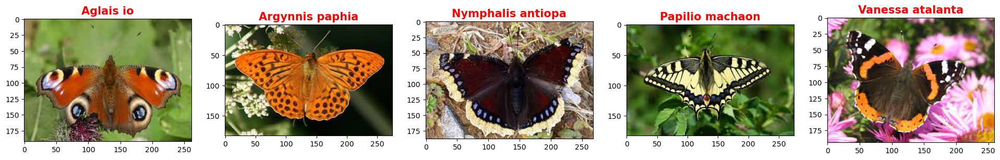

In [5]:
"""At the moment I am considering 5 species"""
image_0 = cv2.imread('Dataset/Train/Aglais_io_1.jpg',cv2.IMREAD_COLOR)
image_0 = cv2.cvtColor(image_0, cv2.COLOR_BGR2RGB)
image_1 = cv2.imread('Dataset/Train/Argynnis_paphia_1.jpg',cv2.IMREAD_COLOR)
image_1 = cv2.cvtColor(image_1, cv2.COLOR_BGR2RGB)
image_2 = cv2.imread('Dataset/Train/Nymphalis_antiopa_1.jpg',cv2.IMREAD_COLOR)
image_2 = cv2.cvtColor(image_2, cv2.COLOR_BGR2RGB)
image_3 = cv2.imread('Dataset/Train/Papilio_machaon_1.jpg',cv2.IMREAD_COLOR)
image_3 = cv2.cvtColor(image_3, cv2.COLOR_BGR2RGB)
image_4 = cv2.imread('Dataset/Train/Vanessa_atalanta_1.jpg',cv2.IMREAD_COLOR)
image_4 = cv2.cvtColor(image_4, cv2.COLOR_BGR2RGB)
fig = plt.figure(figsize=(24,24));
ax1 = fig.add_subplot(1,5,1);
ax1.imshow(image_0);
ax1.set_title('Aglais io', fontsize=15, color= 'Red', fontweight='bold');
ax2 = fig.add_subplot(1,5,2)
ax2.imshow(image_1);
ax2.set_title('Argynnis paphia', fontsize=15, color= 'Red', fontweight='bold');
ax3 = fig.add_subplot(1,5,3)
ax3.imshow(image_2);
ax3.set_title('Nymphalis antiopa', fontsize=15, color= 'Red', fontweight='bold');
ax4 = fig.add_subplot(1,5,4)
ax4.imshow(image_3);
ax4.set_title('Papilio machaon', fontsize=15, color= 'Red', fontweight='bold');
ax5 = fig.add_subplot(1,5,5)
ax5.imshow(image_4);
ax5.set_title('Vanessa atalanta', fontsize=15, color= 'Red', fontweight='bold');

# 2. Data preprocessing

### 2.1 A few words about images name.

To make it easier, the name of the images are matched with the species of butterflys. For example Aglais_io_1.jpg

### 2.2. Generate additional images for teaching data using the ImageDataGenerator class.

In [6]:
#from keras.preprocessing.image import ImageDataGenerator

In [7]:

"""rotation_range : rotation by +/- 45 degrees,
width_shift_range : pixel shift by width by distance -/+ 0.2,
height_shift_range : pixel shift by height by distance -/+ 0.2,
shear_range : Shear angle in counter-clockwise direction in degrees,
zoom_range : Range for random zoom [1-zoom_range, 1+zoom_range],
horizontal_flip : Randomly flip inputs horizontally,
fill_mode : Fill dark pixels after the image has been processed,  
brightness_range : brightens or darkens the generated image. """
#datagen = ImageDataGenerator(
#    rotation_range=70,
#    width_shift_range=0.2,
#    height_shift_range=0.2,
#    shear_range=0.2,
#    zoom_range=0.2,
#    brightness_range=[0.3,1.2],
#    horizontal_flip=True,
#    fill_mode='reflect',    
#)

'rotation_range : rotation by +/- 45 degrees,\nwidth_shift_range : pixel shift by width by distance -/+ 0.2,\nheight_shift_range : pixel shift by height by distance -/+ 0.2,\nshear_range : Shear angle in counter-clockwise direction in degrees,\nzoom_range : Range for random zoom [1-zoom_range, 1+zoom_range],\nhorizontal_flip : Randomly flip inputs horizontally,\nfill_mode : Fill dark pixels after the image has been processed,  \nbrightness_range : brightens or darkens the generated image. '

In [8]:
def images_generation(input_path, output_path, batch_size, num_of_processes_per_image):
    """Generate images from existing ones. For each image, a number of images is generated according to num_of_processes_per_image"""
    try:
        for image in os.listdir(input_path):
            prefix = image.replace('.jpg','')
            image = cv2.imread(f'{input_path}/{image}',cv2.IMREAD_COLOR)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image = image.reshape((1,) + image.shape)
            i = 1
            for batch in datagen.flow(image,batch_size=batch_size,save_to_dir=output_path, save_prefix = f'{prefix}', save_format='jpg'):
                i += 1
                if i == num_of_processes_per_image:
                    break
    except FileNotFoundError:
        print("No such file or directory. Check the source path or destination folder ")

In [9]:
#images_generation('Dataset/Train','Dataset/Train_samples', 10, 52)

I have generated images using  ImageDataGenerator provided by keras.preprocessing.image  to increase the number of images for learning and to reduce the possibility of model overfitting. I know that is not the best possibilites but i had a small number
of butterfly images. The images I downloaded from google were unlicensed. Of course, the images have already been generated.  

### 2.3. Prepering datasets.

Changing images to matrices and mapping them to categories.

In [10]:
import re
import random
def make_set(path):
    """Main idea: read images, convert bgr to rgb,rescaling to 128x128, normalisation to 0-1 , labeling in numpy array format based on the image file name. Then append list [image, label] into dataset list
    Finaly convertion of the list into X numpy array with images matrixes, adn y numpy array with labels."""
    try:
        dataset = []
        for i in os.listdir(path):
            image = cv2.imread(f'{path}/{i}',cv2.IMREAD_COLOR)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image = cv2.resize(image,(110, 110))
            image = image / 255.0 #normalization
            if re.findall("^Aglais_io", i):
                label = [1, 0, 0, 0, 0]
            elif re.findall("^Argynnis_paphia", i):
                label =[0, 1, 0, 0, 0]
            elif re.findall("^Nymphalis_antiopa", i):
                label =[0, 0, 1, 0, 0]
            elif re.findall("^Papilio_machaon", i):
                label =[0, 0, 0, 1, 0]
            else:
                label =[0, 0, 0, 0, 1]
            dataset.append([image, label])

        random.shuffle(dataset)

        X = []
        y = []
        for image, label in dataset:
            X.append(image)
            y.append(label)
        return np.array(X, dtype = 'float32'), np.array(y, dtype = 'int32')
    except FileNotFoundError:
        print("No such file or directory. Check the source path or destination folder ")

In [11]:

#X_train, y_train = make_set('Dataset/Train_samples')
#X_valid, y_valid = make_set('Dataset/Validation')
#X_test, y_test = make_set('Dataset/Test')


In [12]:
import pickle
def save_ready_dataset(X, y, path, X_name, y_name):
    try:
        pickle_out = open(f"{path}/{X_name}.pickle","wb")
        pickle.dump(X, pickle_out)
        pickle_out.close()

        pickle_out = open(f"{path}/{y_name}.pickle","wb")
        pickle.dump(y, pickle_out)
        pickle_out.close()
    except FileNotFoundError:
        print("No such file or directory. Check the source path or destination folder ")


In [13]:
#save_ready_dataset(X_train, y_train, path = 'Ready_Datasets\Train', X_name = 'X_train', y_name ='y_train')
#save_ready_dataset(X_valid, y_valid, path = 'Ready_Datasets\Validation', X_name = 'X_valid', y_name ='y_valid')
#save_ready_dataset(X_test, y_test, path = 'Ready_Datasets\Test', X_name = 'X_test', y_name ='y_test')

I have saved/ serialized datasets using pickle.

# 3.Neural network design

### 3.1. Loading and dataset checking.

In [14]:
# You can load the datasets if you have saved it using save_ready_dataset function
import pickle
"""Train"""
with open('Ready_Datasets\Train\X_train.pickle',"rb") as pickle_in_X_train:
    X_train = pickle.load(pickle_in_X_train)
with open('Ready_Datasets\Train\y_train.pickle',"rb") as pickle_in_y_train:
    y_train = pickle.load(pickle_in_y_train)
"""Validation"""
with open('Ready_Datasets\Validation\X_valid.pickle',"rb") as pickle_in_X_valid:
    X_valid = pickle.load(pickle_in_X_valid)
with open('Ready_Datasets\Validation\y_valid.pickle',"rb") as pickle_in_y_valid:
    y_valid = pickle.load(pickle_in_y_valid)
"""Test"""
with open('Ready_Datasets\Test\X_test.pickle',"rb") as pickle_in_X_test:
    X_test = pickle.load(pickle_in_X_test)
with open('Ready_Datasets\Test\y_test.pickle',"rb") as pickle_in_y_test:
    y_test = pickle.load(pickle_in_y_test)

In [15]:
def count_label_dist(y):
    labels_dist_dict = {'Aglais io':0, 'Argynnis paphia':0, 'Nymphalis antiopa':0, 'Papilio machaon':0, 'Vanessa atalanta':0}
    for i in y:
        if np.array_equal([1, 0, 0, 0, 0], i, equal_nan=False):
            labels_dist_dict['Aglais io'] += 1
        elif np.array_equal([0, 1, 0, 0, 0], i, equal_nan=False):
            labels_dist_dict['Argynnis paphia'] += 1
        elif np.array_equal([0, 0, 1, 0, 0], i, equal_nan=False):
            labels_dist_dict['Nymphalis antiopa'] += 1
        elif np.array_equal([0, 0, 0, 1, 0], i, equal_nan=False):
            labels_dist_dict['Papilio machaon'] += 1
        else:
            labels_dist_dict['Vanessa atalanta'] += 1
    return labels_dist_dict


In [16]:
import numpy as np
train_distibution = count_label_dist(y_train)
valid_distibution = count_label_dist(y_valid)
test_distibution = count_label_dist(y_test)

In [17]:
import pandas as pd
Dataset_Distribution = pd.DataFrame({'Train distribution': (train_distibution),
                            'Validation distribution': (valid_distibution),
                            'Test distribution': (test_distibution)},
                            index=["Aglais io", "Argynnis paphia" , "Nymphalis antiopa", "Papilio machaon", "Vanessa atalanta"])

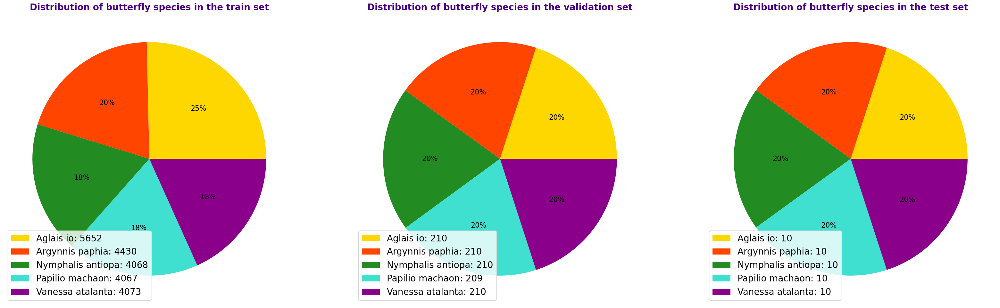

In [18]:
colors = ['gold', 'orangered', 'forestgreen', 'turquoise', 'darkmagenta']
fig = plt.figure(figsize=(40,60));
ax1 = fig.add_subplot(1,3,1);
labels_train = [f"Aglais io: {Dataset_Distribution['Train distribution'][0]}", 
          f"Argynnis paphia: {Dataset_Distribution['Train distribution'][1]}", 
          f"Nymphalis antiopa: {Dataset_Distribution['Train distribution'][2]}", 
          f"Papilio machaon: {Dataset_Distribution['Train distribution'][3]}", 
          f"Vanessa atalanta: {Dataset_Distribution['Train distribution'][4]}"]
ax1.pie(Dataset_Distribution['Train distribution'], colors=colors, autopct='%.0f%%',textprops={'fontsize': 16});
ax1.set_title('Distribution of butterfly species in the train set', fontsize=20, color= 'indigo', fontweight='bold',);
ax1.legend(labels_train, loc='lower left', fontsize=20);
ax2 = fig.add_subplot(1,3,2)
labels_valid = [f"Aglais io: {Dataset_Distribution['Validation distribution'][0]}", 
          f"Argynnis paphia: {Dataset_Distribution['Validation distribution'][1]}", 
          f"Nymphalis antiopa: {Dataset_Distribution['Validation distribution'][2]}", 
          f"Papilio machaon: {Dataset_Distribution['Validation distribution'][3]}", 
          f"Vanessa atalanta: {Dataset_Distribution['Validation distribution'][4]}"]
ax2.pie(Dataset_Distribution['Validation distribution'], colors=colors, autopct='%.0f%%',textprops={'fontsize': 16});
ax2.set_title('Distribution of butterfly species in the validation set', fontsize=20, color= 'indigo', fontweight='bold');
ax2.legend(labels_valid, loc='lower left', fontsize=20);
ax3 = fig.add_subplot(1,3,3)
labels_test= [f"Aglais io: {Dataset_Distribution['Test distribution'][0]}", 
          f"Argynnis paphia: {Dataset_Distribution['Test distribution'][1]}", 
          f"Nymphalis antiopa: {Dataset_Distribution['Test distribution'][2]}", 
          f"Papilio machaon: {Dataset_Distribution['Test distribution'][3]}", 
          f"Vanessa atalanta: {Dataset_Distribution['Test distribution'][4]}"]
ax3.pie(Dataset_Distribution['Test distribution'], colors=colors, autopct='%.0f%%',textprops={'fontsize': 16});
ax3.set_title('Distribution of butterfly species in the test set', fontsize=20, color= 'indigo', fontweight='bold');
ax3.legend(labels_test, loc='lower left', fontsize=20);

### 3.2. Schemat of the Neural network

In [19]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.layers import Conv2D, MaxPooling2D

In [20]:
#from keras.callbacks import CSVLogger
#csv_logger = CSVLogger('Model Stats.log', separator=',', append=False)

In [21]:
def model_training():
    model = Sequential() #  model with exactly one input tensor and one output tensor. That's why i used output as numpy array of shape (5,) for example [0,1,0,0,0]

    model.add(Conv2D(128, (3, 3), input_shape=X_train.shape[1:])) 
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))



    model.add(Conv2D(128, (3, 3)))
    model.add(Activation("relu"))
    model.add(MaxPooling2D(pool_size=(2, 2)))



    model.add(Conv2D(128, (3, 3)))
    model.add(Activation("relu"))
    model.add(MaxPooling2D(pool_size=(2, 2)))


    model.add(Conv2D(128, (3, 3)))
    model.add(Activation("relu"))
    model.add(MaxPooling2D(pool_size=(2, 2)))


    model.add(Conv2D(128, (3, 3)))
    model.add(Activation("relu"))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.5))

    model.add(Flatten())

    model.add(Dense(128))
    model.add(Activation('softplus'))
    model.add(Dropout(0.5))
    model.add(Dense(5, activation=tf.nn.softmax))

    model.compile(loss='categorical_crossentropy',
                  optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
                  metrics=['accuracy','AUC',])

    cnn = model.fit(X_train, y_train, batch_size=32, epochs=30, validation_data=(X_valid, y_valid),callbacks=[csv_logger])
    return cnn

In [22]:
"""Model is already saved"""
#model_train()

'Model is already saved'

In [23]:
"""saving the model as the name suggests"""
#model.save('CNN_Model1')

'saving the model as the name suggests'

I have selected model scheme by trial and error method, evaluating many models with different numbers of convolutional layer, with different number of filters and so on.

### 3.4 Model summary

In [24]:
#from tensorflow import keras
cnn = keras.models.load_model('CNN_Model1')
cnn.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 108, 108, 128)     3584      
                                                                 
 activation (Activation)     (None, 108, 108, 128)     0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 54, 54, 128)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 52, 52, 128)       147584    
                                                                 
 activation_1 (Activation)   (None, 52, 52, 128)       0         
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 26, 26, 128)      0         
 2D)                                                    

# 4. Model evaluation.

### 4.1 . Methods for model evaluation.

In [22]:
#from tensorflow import keras
#cnn = keras.models.load_model('CNN_Model1')

In [25]:
def conf_matrix(y_predict, y_actual):
    y1 = []
    for i in range(len(y_predict)):
        max_val = y_predict[i].max()
        pred_array = []
        for index, value in enumerate(y_predict[i]):
            if value == max_val:
                pred_array.insert(index, 1.)
            else:
                pred_array.insert(index, 0.)
        y1.append(pred_array)
    y1 = np.array(y1, dtype ='int')
    y_predict = y1
    conf_matrix = np.zeros((5,5), dtype='int')
    species_list = [[1,0,0,0,0],[0,1,0,0,0],[0,0,1,0,0],[0,0,0,1,0],[0,0,0,0,1]]
    for i in range(len(y_actual)):
        for j in range(len(species_list)):
            if (y_predict[i] == species_list[j]).all() and (y_actual[i] == species_list[0]).all():
                conf_matrix[j,0] +=1
                break
            elif (y_predict[i] == species_list[j]).all() and (y_actual[i] == species_list[1]).all():
                conf_matrix[j,1] +=1
                break
            elif (y_predict[i] == species_list[j]).all() and (y_actual[i] == species_list[2]).all():
                conf_matrix[j,2] +=1
                break
            elif (y_predict[i] == species_list[j]).all() and (y_actual[i] == species_list[3]).all():
                conf_matrix[j,3] +=1
                break
            elif (y_predict[i] == species_list[j]).all() and (y_actual[i] == species_list[4]).all():
                conf_matrix[j,4] +=1
                break
            
    return conf_matrix        
        

In [26]:
import numpy as np
import pandas as pd
def color_matrix(df):
        array = np.full(df.shape, 'background-color: Tomato', dtype='<U24') 
        np.fill_diagonal(array, 'background-color: Green')
        return pd.DataFrame( array, index=df.index, columns=df.columns)

def draw_conf_matrix(conf_matrix, name):
    Conf_Matrix = pd.DataFrame(conf_matrix,
                   index=pd.Index(["Aglais io", "Argynnis paphia" , "Nymphalis antiopa", "Papilio machaon", "Vanessa atalanta"], name='Predict ↓'),
                   columns=pd.MultiIndex.from_product([[f'Confusion Matrix for {name} dataset'],["Aglais io", "Argynnis paphia" , "Nymphalis antiopa", "Papilio machaon", "Vanessa atalanta"]], names=['', 'Actual →']))
    
    
    return Conf_Matrix.style.apply(color_matrix, axis=None).set_table_styles([
    {'selector': 'th.col_heading.level0', 'props': 'font-size: 2em;'},
    {'selector': 'th','props': 'font-size: 1.25em; background-color: #428df5; color: white;  text-align: center;'},
    {'selector': 'th.col_heading', 'props': 'font-size: 1.25em; text-align: center;'},
    {'selector': 'th.row_heading', 'props': 'font-size: 1.25em; text-align: center;'},
    {'selector': 'td', 'props': 'text-align: center; font-weight: bold;font-size: 1.5em;'},])
    
    

In [27]:
def Evaluation(conf_matrix, setname):
    """ Methoda determines the model evaluation metrics such as Recall/Sensitivity, Precision, Specifity, F-Score, Accuracy."""
    #Recall/Sensitivity
    Aglais_io_sensitivity = conf_matrix[0,0] /(conf_matrix[0,0] + np.sum(np.delete(conf_matrix[:,0], 0)))
    Argynnis_paphi_sensitivity = conf_matrix[1,1] /(conf_matrix[1,1] + np.sum(np.delete(conf_matrix[:,1], 1)))
    Nymphalis_antiopa_sensitivity = conf_matrix[2,2] /(conf_matrix[2,2] + np.sum(np.delete(conf_matrix[:,2], 2)))
    Papilio_machaon_sensitivity = conf_matrix[3,3] /(conf_matrix[3,3] + np.sum(np.delete(conf_matrix[:,3], 3)))
    Vanessa_atalanta_sensitivity = conf_matrix[4,4] /(conf_matrix[4,4] + np.sum(np.delete(conf_matrix[:,4], 4)))
    Avg_sensitivity = (Aglais_io_sensitivity+Argynnis_paphi_sensitivity+Nymphalis_antiopa_sensitivity+Papilio_machaon_sensitivity+Vanessa_atalanta_sensitivity)/5
    #Precision
    Aglais_io_precision = conf_matrix[0,0] /(conf_matrix[0,0] + np.sum(np.delete(conf_matrix[0,:], 0)))
    Argynnis_paphi_precision = conf_matrix[1,1] /(conf_matrix[1,1] + np.sum(np.delete(conf_matrix[1,:], 1)))
    Nymphalis_antiopa_precision = conf_matrix[2,2] /(conf_matrix[2,2] + np.sum(np.delete(conf_matrix[2,:], 2)))
    Papilio_machaon_precision = conf_matrix[3,3] /(conf_matrix[3,3] + np.sum(np.delete(conf_matrix[3,:], 3)))
    Vanessa_atalanta_precision = conf_matrix[4,4] /(conf_matrix[4,4] + np.sum(np.delete(conf_matrix[4,:], 4)))
    Avg_precision = (Aglais_io_precision+Argynnis_paphi_precision+Nymphalis_antiopa_precision+Papilio_machaon_precision+Vanessa_atalanta_precision)/5
    #Specifity
    Aglais_io_specifity = np.sum(np.delete(np.delete(conf_matrix, 0, 0),0,1))/(np.sum(np.delete(np.delete(conf_matrix, 0, 0),0,1)) + np.sum(np.delete(conf_matrix[0,:], 0)))
    Argynnis_paphi_specifity = np.sum(np.delete(np.delete(conf_matrix, 1, 0),1,1))/(np.sum(np.delete(np.delete(conf_matrix, 1, 0),1,1)) + np.sum(np.delete(conf_matrix[1,:], 1)))
    Nymphalis_antiopa_specifity = np.sum(np.delete(np.delete(conf_matrix, 2, 0),2,1))/(np.sum(np.delete(np.delete(conf_matrix, 2, 0),2,1)) + np.sum(np.delete(conf_matrix[2,:], 2)))
    Papilio_machaon_specifity = np.sum(np.delete(np.delete(conf_matrix, 3, 0),3,1))/(np.sum(np.delete(np.delete(conf_matrix, 3, 0),3,1)) + np.sum(np.delete(conf_matrix[3,:], 3)))
    Vanessa_atalanta_specifity = np.sum(np.delete(np.delete(conf_matrix, 4, 0),4,1))/(np.sum(np.delete(np.delete(conf_matrix, 4, 0),4,1)) + np.sum(np.delete(conf_matrix[4,:], 4)))
    Avg_specifity = (Aglais_io_specifity+Argynnis_paphi_specifity+Nymphalis_antiopa_specifity+Papilio_machaon_specifity+Vanessa_atalanta_specifity)/5
    #F1_score
    Aglais_io_f1_score = (2*Aglais_io_precision * Aglais_io_sensitivity)/(Aglais_io_precision + Aglais_io_sensitivity)
    Argynnis_paphi_f1_score = (2*Argynnis_paphi_precision * Argynnis_paphi_sensitivity)/(Argynnis_paphi_precision + Argynnis_paphi_sensitivity)
    Nymphalis_antiopa_f1_score = (2*Nymphalis_antiopa_precision * Nymphalis_antiopa_sensitivity)/(Nymphalis_antiopa_precision + Nymphalis_antiopa_sensitivity) 
    Papilio_machaon_f1_score = (2*Papilio_machaon_precision * Papilio_machaon_sensitivity)/(Papilio_machaon_precision + Papilio_machaon_sensitivity)
    Vanessa_atalanta_f1_score = (2*Vanessa_atalanta_precision * Vanessa_atalanta_sensitivity)/(Vanessa_atalanta_precision + Vanessa_atalanta_sensitivity)
    Avg_f1_score = (Aglais_io_f1_score+Argynnis_paphi_f1_score+Nymphalis_antiopa_f1_score+Papilio_machaon_f1_score+Vanessa_atalanta_f1_score)/5
    #Accuracy
    Accuracy = (conf_matrix[0,0] + conf_matrix[1,1] + conf_matrix[2,2] +conf_matrix[3,3]+conf_matrix[4,4])/ np.sum(conf_matrix)
    Scores_table = [[Aglais_io_sensitivity, Aglais_io_precision,  Aglais_io_specifity, Aglais_io_f1_score],
                    [Argynnis_paphi_sensitivity, Argynnis_paphi_precision,  Argynnis_paphi_specifity, Argynnis_paphi_f1_score],
                    [Nymphalis_antiopa_sensitivity, Nymphalis_antiopa_precision,  Nymphalis_antiopa_specifity,Nymphalis_antiopa_f1_score],
                    [Papilio_machaon_sensitivity, Papilio_machaon_precision,  Papilio_machaon_specifity, Papilio_machaon_f1_score],
                    [Vanessa_atalanta_sensitivity, Vanessa_atalanta_precision,  Vanessa_atalanta_specifity, Vanessa_atalanta_f1_score],
                    [Avg_sensitivity, Avg_precision,  Avg_specifity, Avg_f1_score],
                    ['','','',Accuracy]
                   ]
    
    Evaluation_scores = pd.DataFrame(Scores_table
                            , index = ["Aglais io", "Argynnis paphia" , "Nymphalis antiopa", "Papilio machaon", "Vanessa atalanta","Avarage value", "Accuracy"],
                            columns=pd.MultiIndex.from_product([[f'Evaluation metrics for {setname} dataset '],["Recall/Sensivity", "Precision", "Specifity", "F1-Score"]])        
                            )
    return Evaluation_scores.style.set_table_styles([
    {'selector': 'th.col_heading.level0', 'props': 'font-size: 2.0em; text-align: centre; background-color: #ac1aeb'},
    {'selector': 'th.col_heading', 'props': 'font-size: 1.5em; text-align: center; background-color: #ac1aeb'},
    {'selector': 'th.row_heading', 'props': 'font-size: 1.5em; text-align: center; background-color: #ac1aeb'},
    {'selector': 'th','props': 'background-color: #ac1aeb;'},
    {'selector': 'td', 'props': 'font-size: 1.5em; text-align: center; background-color: #b0eb1a; color: green;'},  
    ])
  

### 4.2 . Training dataset evaluation.

The methods of evaluation I have chosen are Confusion Matrix and on its basis I evaluate the model using Precision, Recall/Sensitivity, Specifity, F1-score for every butterfly category and avarage values for all categories for each methods, finally accuracy for all categories.  

#### 4.2.1. Confusion Matrix. 

In [28]:
Confusion_Matrix_train = conf_matrix(cnn.predict(X_train),y_train)

697/697 [==============================] - 100s 134ms/step


In [29]:
draw_conf_matrix(Confusion_Matrix_train, "Training")

#### 4.2.2. Metrics for Categorical evaluation based on Confusion matrix.

In [30]:
Evaluation(conf_matrix = Confusion_Matrix_train, setname = "Training")

### 4.3 . Validation dataset evaluation.

#### 4.3.1. Confusion Matrix. 

In [31]:
Confusion_Matrix_validation = conf_matrix(cnn.predict(X_valid), y_valid)

33/33 [==============================] - 5s 132ms/step


In [32]:
draw_conf_matrix(Confusion_Matrix_validation, "Validation")

#### 4.3.2. Metrics for Categorical evaluation based on Confusion matrix.

In [33]:
Evaluation(conf_matrix = Confusion_Matrix_validation, setname = "Validation")

### 4.4 . Testing dataset evaluation.

#### 4.4.1. Confusion Matrix. 

In [34]:
Confusion_Matrix_test = conf_matrix(cnn.predict(X_test), y_test)

2/2 [==============================] - 0s 70ms/step


In [35]:
draw_conf_matrix(Confusion_Matrix_test, "Testing")

#### 4.4.2. Metrics for Categorical evaluation based on Confusion matrix.

In [36]:
Evaluation(conf_matrix = Confusion_Matrix_test, setname = "Testing")

### 4.5. Checking model performance on private butterfly images.

#### 4.5.1. Checing folder with butterfly images.

In [37]:
def multi_images_prediction(folder_path, model):
    """the method for displaying an image of a butterfly and predicting which species it belongs."""
    for i in os.listdir(folder_path):
        image = cv2.imread(f'{folder_path}/{i}',cv2.IMREAD_COLOR)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image_0 = image
        image = cv2.resize(image,(110, 110))
        image = image / 255.0 #normalization
        array_prediction =  np.round(model.predict(image.reshape((1,) + image.shape),verbose = 0),2)
        mylabels = ["Aglais io", "Argynnis paphia" , "Nymphalis antiopa", "Papilio machaon", "Vanessa atalanta"]
        actual_label = f"{i.split('_')[0]} {i.split('_')[1]}"
        fig = plt.figure(figsize=(20,10));
        ax1 = fig.add_subplot(1,2,1);
        ax1.imshow(image_0);
        ax1.set_title(f"Actual spieces name: {actual_label}", fontsize=15, color = "green")
        ax2 = fig.add_subplot(1,2,2)
        ax2.bar(mylabels,  array_prediction[0]*100);
        for i in range(len(mylabels)):
            plt.text(i-0.1,array_prediction[0][i]*100 + 1,f"{round(array_prediction[0][i]*100,2)}%");
        ax2.set_ylabel('species probability distribution', fontsize=15);
        if mylabels[np.argmax(array_prediction)] == actual_label:
            ax2.set_title(f"Predicted spieces name base on argmax: {mylabels[np.argmax(array_prediction)]} ", fontsize=15, color = "green")
        else:
            ax2.set_title(f"Predicted spieces name base on argmax: {mylabels[np.argmax(array_prediction)]} ", fontsize=15, color = "red")
           

C:\Users\Cezary\AppData\Local\Temp\ipykernel_14176\2585413579.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(20,10));


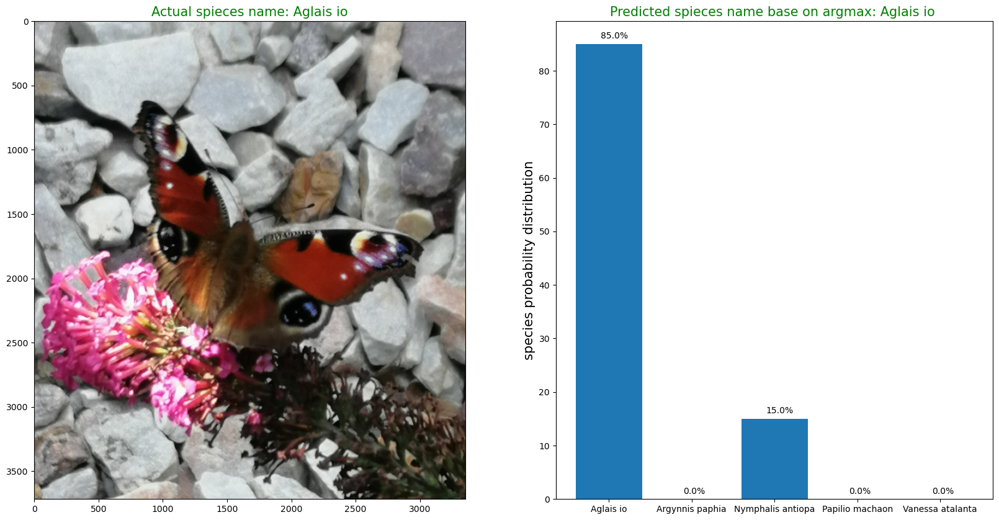

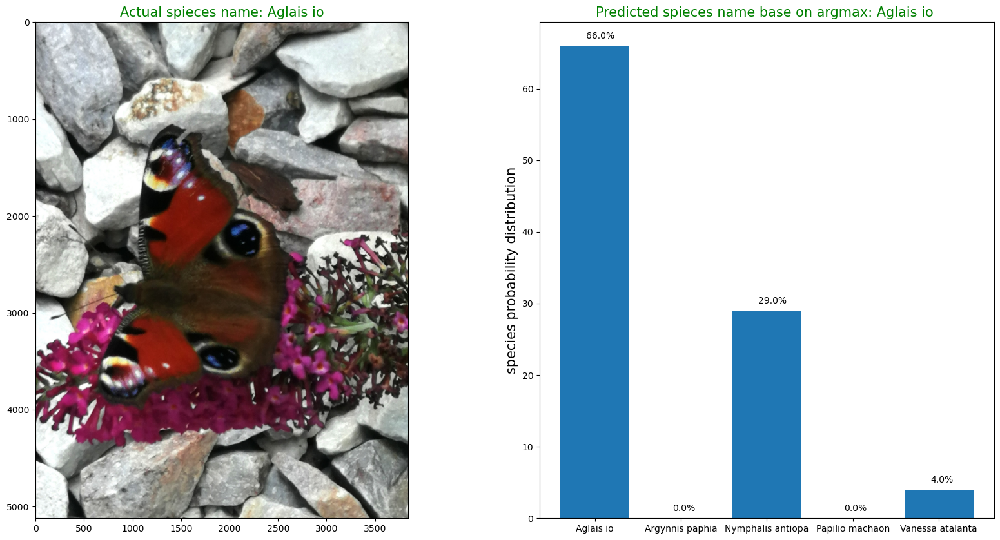

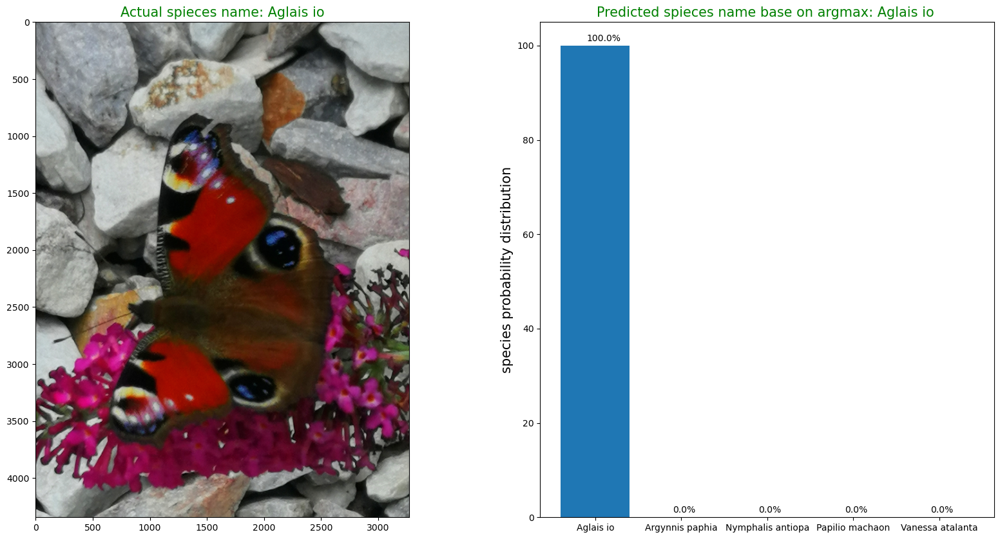

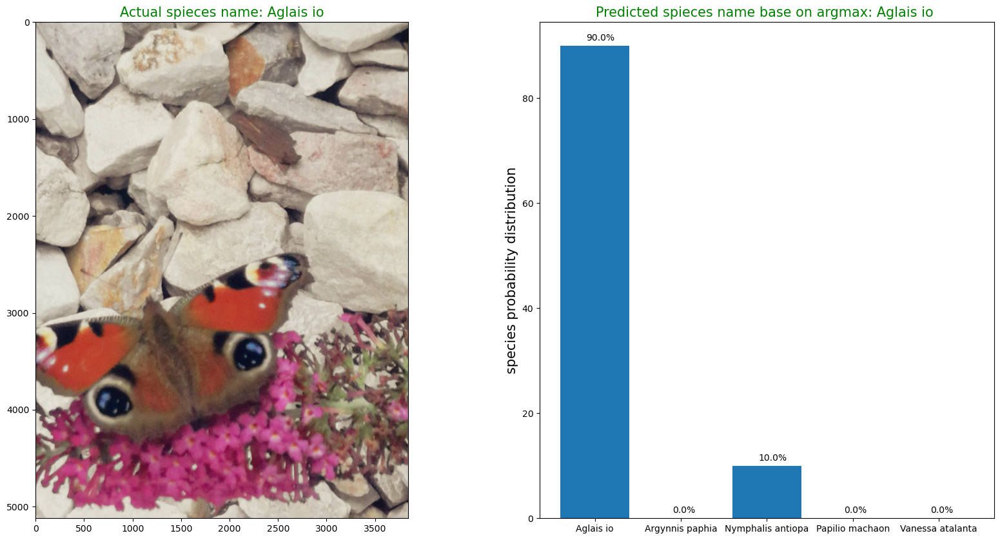

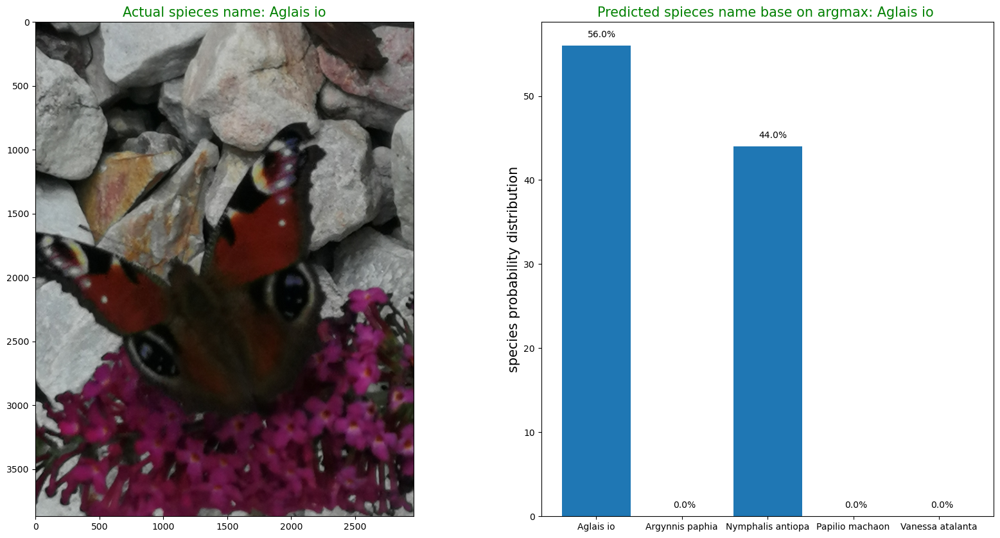

...

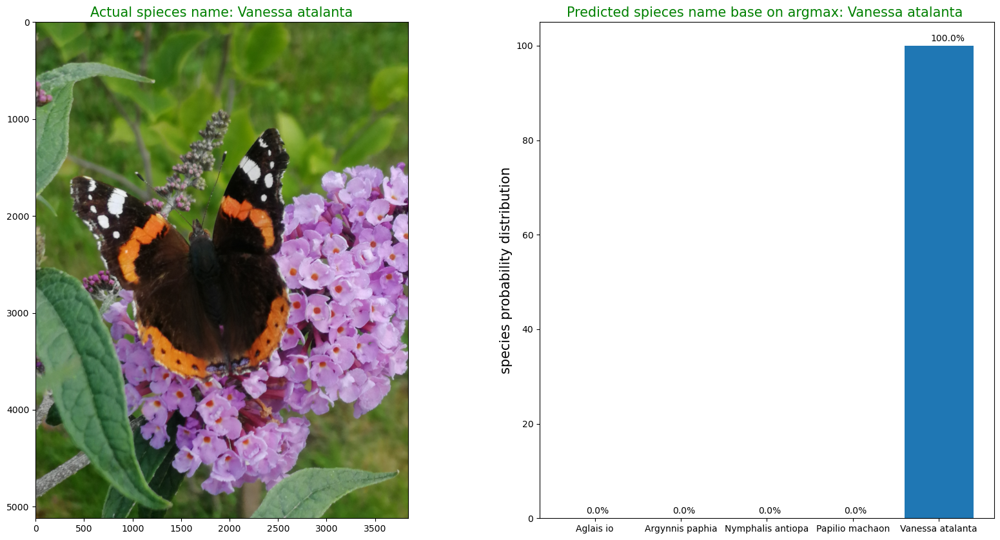

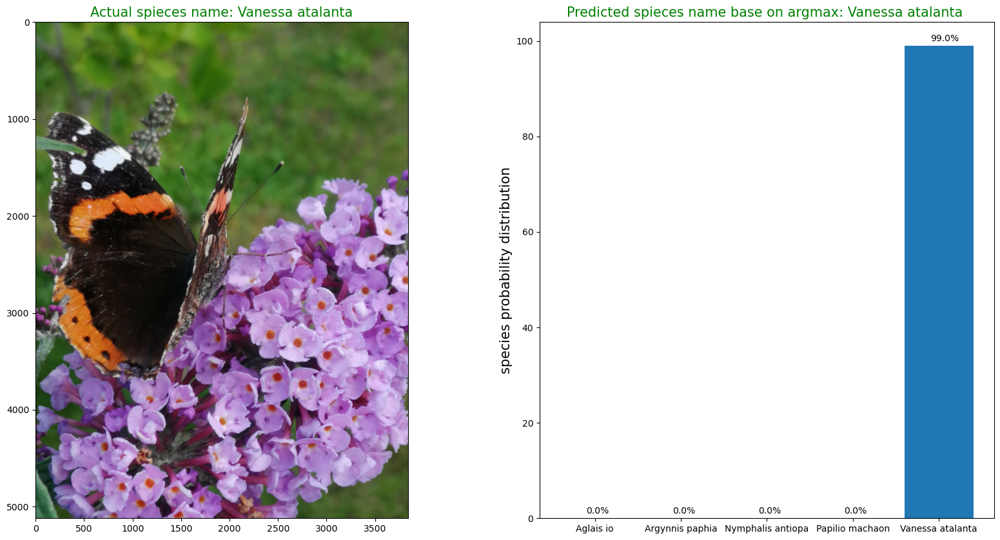

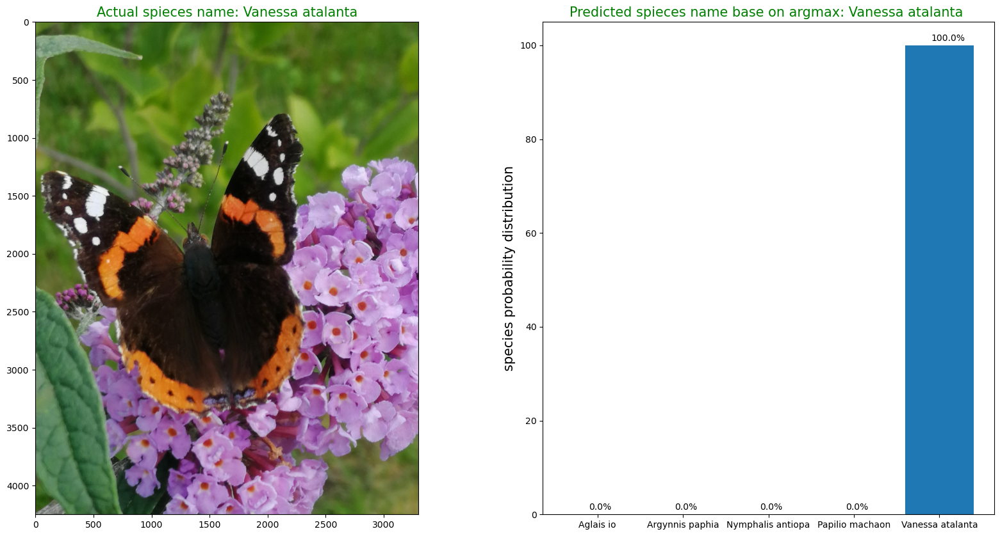

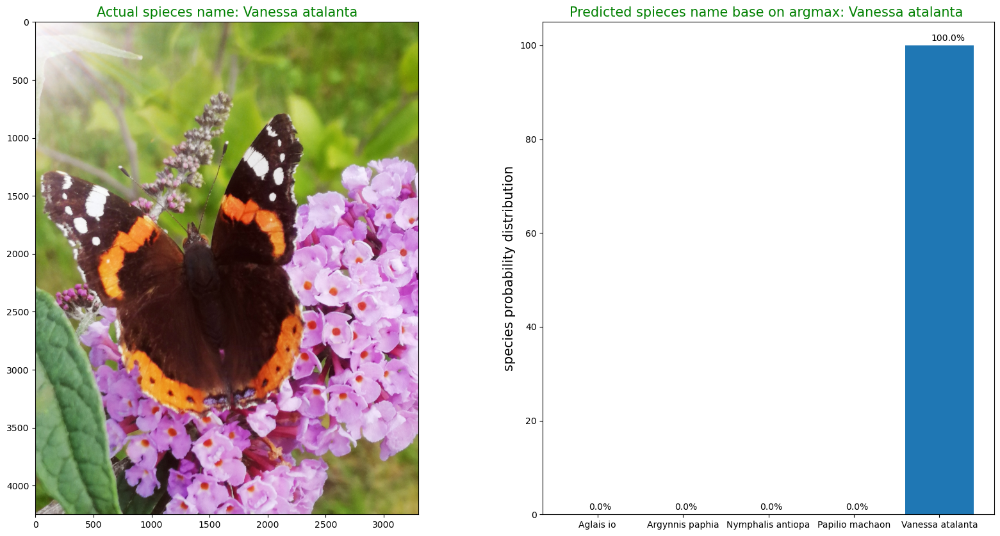

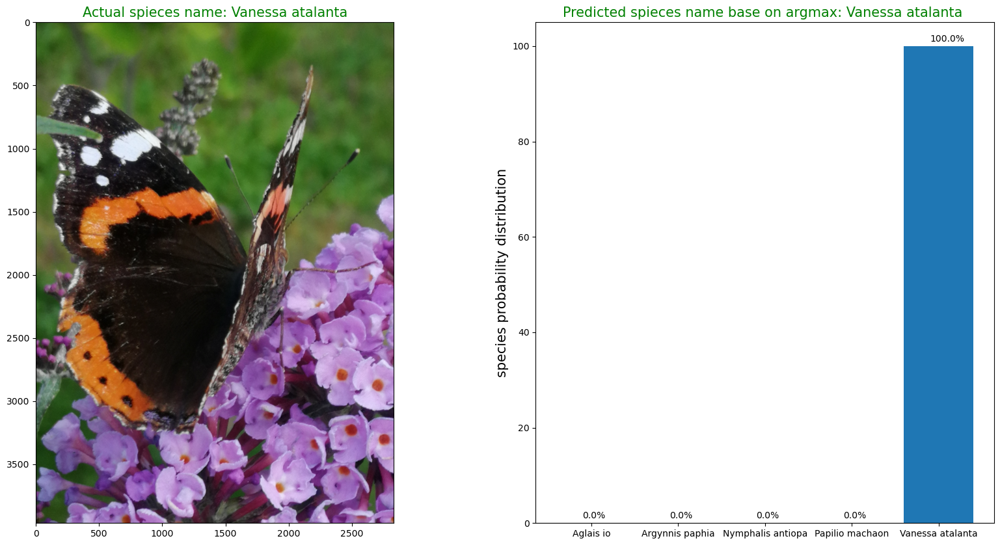

In [38]:
try:
    multi_images_prediction("Dataset/Private_images", cnn)
except NameError:
    print("Check the model name or whether such a model exists.")
except FileNotFoundError:
        print("No such file or directory. Check the source path or destination folder ")

#### 4.5.2. Checing a single image of a butterfly.

In [39]:
def single_images_prediction(image_path, model):
    """the method for displaying an image of a butterfly and predicting which species it belongs."""
    image = cv2.imread(image_path,cv2.IMREAD_COLOR)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_0 = image
    image = cv2.resize(image,(110, 110))
    image = image / 255.0 #normalization
    array_prediction =  np.round(model.predict(image.reshape((1,) + image.shape),verbose = 0),2)
    mylabels = ["Aglais io", "Argynnis paphia" , "Nymphalis antiopa", "Papilio machaon", "Vanessa atalanta"]
    actual_label = f"{image_path.split('/')[len(image_path.split('/'))-1].split('_')[0]} {image_path.split('/')[len(image_path.split('/'))-1].split('_')[1]}"
    fig = plt.figure(figsize=(20,10));
    ax1 = fig.add_subplot(1,2,1);
    ax1.imshow(image_0);
    ax1.set_title(f"Actual spieces name: {actual_label}", fontsize=15, color = "green")
    ax2 = fig.add_subplot(1,2,2)
    ax2.bar(mylabels,  array_prediction[0]*100);
    for i in range(len(mylabels)):
        plt.text(i-0.1,array_prediction[0][i]*100 + 1,f"{round(array_prediction[0][i]*100,2)}%");
    ax2.set_ylabel('species probability distribution', fontsize=15);
    if mylabels[np.argmax(array_prediction)] == actual_label:
        ax2.set_title(f"Predicted spieces name base on argmax: {mylabels[np.argmax(array_prediction)]} ", fontsize=15, color = "green")
    else:
        ax2.set_title(f"Predicted spieces name base on argmax: {mylabels[np.argmax(array_prediction)]} ", fontsize=15, color = "red")

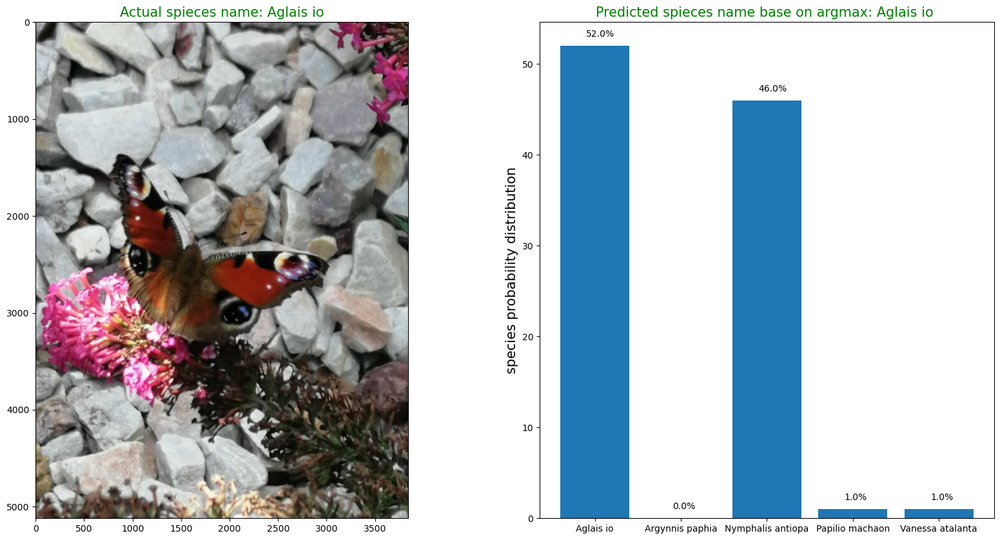

In [40]:
try:
    single_images_prediction('Dataset/Private_images/Aglais_io_4_test.jpg', cnn)
except NameError:
    print("Check the model name or whether such a model exists.")
except FileNotFoundError:
        print("No such file or directory. Check the source path or destination folder ")

#### 4.5.3. Evaluating the model on private images.

In [41]:
try:
    X_private, y_private = make_set('Dataset/Private_images')
except FileNotFoundError:
        print("No such file or directory. Check the source path or destination folder ")

In [42]:
loss_private, acc_private, auc_private = cnn.evaluate(X_private, y_private, verbose = 0)

### 4.6 Compare training and validation dataset during training the model.

#### 4.6.1. Methods for plotting comparations.

In [43]:
df = pd.read_csv('Model Stats.log')

In [44]:
def dataset_comparation(df):
    """Method shows model accuracy for Training and Validation dataset for each epoch."""
    epochs = range(1,len(df[df.keys()[0]])+1)
    acc_train = df[df.keys()[1]]
    auc_train = df[df.keys()[2]]
    loss_train = df[df.keys()[3]]
    acc_val = df[df.keys()[4]]
    auc_val = df[df.keys()[5]]
    loss_val = df[df.keys()[6]]
    fig = plt.figure(figsize=(20,10));
    ax1 = fig.add_subplot(1,3,1);
    ax1.plot(epochs, acc_train, 'g', label='Training Accuracy')
    ax1.plot(epochs, acc_val, 'b', label='Validation Accuracy')
    ax1.set_title('Training and Validation accuracy')
    ax1.set_xlabel('Epochs')
    ax1.set_ylabel('Accuracy')
    ax1.legend()
    ax2 = fig.add_subplot(1,3,2);
    ax2.plot(epochs, auc_train, 'g', label='Training  Area under curve')
    ax2.plot(epochs, auc_val, 'b', label='Validation  Area under curve')
    ax2.set_title('Training and Validation Area under curve')
    ax2.set_xlabel('Epochs')
    ax2.set_ylabel('Area Under Curve')
    ax2.legend()
    ax3 = fig.add_subplot(1,3,3);
    ax3.plot(epochs, loss_train, 'g', label='Training Loss')
    ax3.plot(epochs, loss_val, 'b', label='Validation Loss')
    ax3.set_title('Training and Validation Loss')
    ax3.set_xlabel('Epochs')
    ax3.set_ylabel('Loss')
    ax3.legend()
    

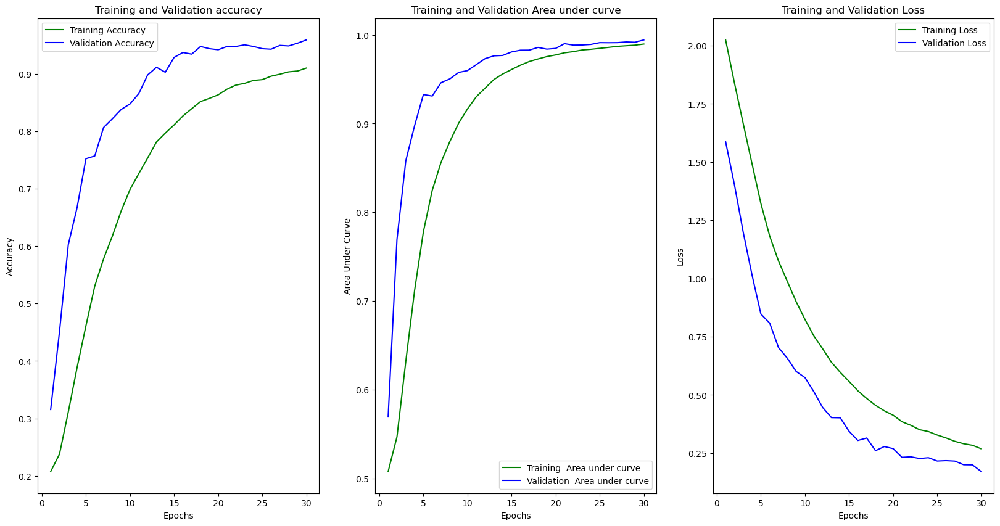

In [45]:
dataset_comparation(df)

#### 4.6.2. Loss, Accuracy and AUC (Area under curve) comparassion for Training, Testing, Validation on Private images dataset.

In [46]:
loss_train, acc_train, auc_train = cnn.evaluate(X_train,y_train, verbose=0)
loss_valid, acc_valid, auc_valid = cnn.evaluate(X_valid,y_valid, verbose=0)
loss_test, acc_test, auc_test = cnn.evaluate(X_test,y_test, verbose=0)
loss_private, acc_private, auc_private = cnn.evaluate(X_private,y_private, verbose=0)
Comparasion = [[loss_train, acc_train, auc_train, len(y_train)],
                [loss_valid, acc_valid, auc_valid, len(y_valid)],
                [loss_test, acc_test, auc_test, len(y_test)],
                [loss_private, acc_private, auc_private, len(y_private)]]
Evaluation_scores = pd.DataFrame(Comparasion
                            , index = ["Training Dataset", "Validation Dataset" , "Testing Dataset", "Private Images Dataset"],
                            columns=pd.MultiIndex.from_product([['Comparison between different data sets'],["Loss", "Accuracy", "AUC","Images count"]])        
                            )
Evaluation_scores.style.set_table_styles([
    {'selector': 'th.col_heading.level0', 'props': 'font-size: 2.0em; text-align: centre; background-color: #ac1aeb'},
    {'selector': 'th.col_heading', 'props': 'font-size: 1.5em; text-align: center; background-color: #ac1aeb'},
    {'selector': 'th.row_heading', 'props': 'font-size: 1.5em; text-align: center; background-color: #ac1aeb'},
    {'selector': 'th','props': 'background-color: #ac1aeb;'},
    {'selector': 'td', 'props': 'font-size: 1.5em; text-align: center; background-color: #b0eb1a; color: green;'},  
    ])

# 5. Summary

Based on a comparasion between different datasets I can conclude that the CNN Model does not appear overfitted. Especially looking at Training, Validation and Private Images Datasets it is possible to see a good balance between bias and variance. In conclusion, maybe the model is not perfect, but it works well enough, considering small data set. This is about 500 unlicensed images from google. Of course i used ImageDataGenerator class from Keras to increase the number of images in the training dataset, but it is still not the ideal number. 

To evaluate the model more precisely, I also used method such as Precission, Recall/Sensitivity, Specifity, F1_score (the closer to one the better):
* Precision - shows the percentage of correctly classified/predicted butterfly species among all those classified as that species,
* Recall/Sensitivity - Sensitivity is the ratio of number of correctly classified butterflies as one species, to the number of correctly classified butterflies as one species and predicted as other species, but for real are this species.
* F1-score - shows the balance between Precision and Recall/Sensitivity
* Specifity - determines whether the model is good at identifying whether a prediction of a particular butterfly does not belong to a particular species.

In my case, in training, validation and testing datase avarage Precision is above 0,94 as well as Recall, so therefore the lowest score for avarage F1 is about 0,94. Avarage Specifity is about 0.98. Based on these numbers i assume that my model works pretty good.
